# Сравнение архитектур автокодировщиков для задачи повышения разрешения

Выполнил:<br>
Губанов Александ, группа №34

Целью практической работы является сравнительный анализ результата работы разных архитектур автокодировщиков в задачах апскейлинга изображений.

In [ ]:
!pip install pyopenssl ndg-httpsclient pyasn1 urllib3
!pip install git+https://github.com/sberbank-ai/Real-ESRGAN.git 

  Cloning https://github.com/sberbank-ai/Real-ESRGAN.git to c:\users\александр\appdata\local\temp\pip-req-build-86rks_dt
  Resolved https://github.com/sberbank-ai/Real-ESRGAN.git to commit 362a0316878f41dbdfbb23657b450c3353de5acf
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'


  Running command git clone --filter=blob:none --quiet https://github.com/sberbank-ai/Real-ESRGAN.git 'C:\Users\Александр\AppData\Local\Temp\pip-req-build-86rks_dt'


In [54]:
import numpy as np
import keras
import matplotlib.pyplot as plt
%matplotlib inline
from keras.models import Model
from keras import utils
from keras.layers import Conv2D, MaxPooling2D, Dense, Input, UpSampling2D, Conv2DTranspose, BatchNormalization, LeakyReLU
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping
import cv2
import os
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
import random
from tqdm import tqdm
import shutil
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import torch.nn as nn
from torchvision.models import vgg19
import torch
from torch import optim
from tqdm.notebook import tqdm
import torchvision.transforms as transforms
from IPython.display import clear_output
import torch
from PIL import Image
from RealESRGAN import RealESRGAN
import matplotlib.image as mpimg


Повышение разрешения - актуальное направление в области нейронных сетей, нашедшее своё применение, в первую очередь, в обработке фотографий и быстрой реставрации старых фильмов.

В рамках данной работы для сравнительного анализа качества повышения разрешения были выбраны:
- классический свёрточный автокодировщик
- SRGAN
- ESRGAN

Автокодировщик - это нейронная сеть прямого распространения, задача которой заключается в реконструкции сигналов. Вся суть данной сети заключается в её архитектуре, представленной на изображении ниже.

![autoencoder_architecture.png](autoencoder_architecture.png "Рис. 1 - архитектура классического автокодировщика")

**Рис. 1 - архитектура классического автокодировщика**

Задача автокодировщика в том, чтобы с минимальными потерями передать сигнал из входа на выход.<br>
Однако препятствует этому "бутылочное горлышко" - скрытый слой или набор скрытых слоев с пониженной размерностью, проход через которые необратимо приведёт к потере данных. Автокодировщик же должен выделить наиболее важные признаки, позволяющие максимально правдоподобно реконструировать входной сигнал с учетом потерь.

Автокодировщик состоит из **энкодера**, сжимающего данные для скрытого слоя (плотного векторного пространства), и декодировщика, реконструирующего сжатый сигнал до исходного состояния

В работе реализован автокодировщик на сверточных слоях, используемых для более качественного извлечения признаков у изображений.


<br><br>
SRGAN (Super Resolution Generative Adversarial Network) - GAN-сеть, архитектура которой изначально рассчитана на выполнение апскейлинга изображений:

![image_1.pn](image_1.png "Рис. 1 - архитектура классического автокодировщика")

**Рис. 2 - архитектура SRGAN**

В отличие от классического автокодировщика, GAN-сеть состоит из генератора, генерирующего изображение (можно сравнить с энкодером), и дискриминатора, определяющего, сгенерировано полученное изображение или нет. Таким образом, GAN-сеть состоит из двух сетей, которые обучаются одновременно: одна учится генерировать качественные изображения, другая - учится их различать. Обучение прекращается, когда дискриминатор не может отличить реальное изображение от обработанного.

SRGAN использует остаточные блоки, т.е. блоки, передающие сигнал в обход некоторых слоёв. Этот сигнал позволяет снизить потери, улучшить выделение признаков и повысить качество апкскейлинга.

В работе для выделения признаков в SRGAN используется предобученная сверточная сеть VGG19.

<br><br>
ESRGAN (Enchanced Super Resolution Generative Adversarial Network) имеет идентичную с SRGAN архитектуру и является его улучшенной версией.

Данная модель использует модифицированные остаточные блоки **Residual in Residual Dense Block (RRDB)**, представляющие собой комбинацию из нескольких классических остаточных блоков вперемешку с полносвязными слоями, без использования нормализации батчей, чтобы повысить выделение деталей на изображении.

![RRDB.png](RRDB.png)

**Рис. 3 - архитектура блока RRDB**

Помимо этого, вместо стандартного дискриминатора ESRGAN использует релятивисткий GAN, которй пытается предсказать вероятность того, что реальное изображение относительно более реалистичное, чем поддельное.

Ввиду ограниченности вычислительных ресурсов, была использована полностью готовая и предобученная версия ESRGAN.

# Подготовка датасета
 
В работе используется датасет __adityachandrasekhar/image-super-resolution__, в сумме содержащий 1710 изображений: 855 в высоком разрешении, и 855 - в низком.

### Подготовка для CAE

In [16]:
# Задаем пути к папкам
train_path = './dataset/train' # тренировочные образцы
val_path = './dataset/val' # контрольные образцы

train_path_hr = os.path.join(train_path, 'high_res')
train_path_lr = os.path.join(train_path, 'low_res')
val_path_hr = os.path.join(val_path, 'high_res')
val_path_lr = os.path.join(val_path, 'low_res')

train_high_res = [] # список файлов без водяных знаков (тренировочная выборка)
train_low_res = []  # список файлов с водяными знаков (тренировочная выборка)
valid_high_res = [] # список файлов без водяных знаков (контрольная выборка)
valid_low_res = [] # список файлов с водяными знаков (контрольная выборка)

# Найдем парные файлы для тренировочной выборки
for file_hr in sorted(os.listdir(train_path_hr)):
    for file_lr in sorted(os.listdir(train_path_lr)):
        # Если имена файлов в обеих папках совпадают, то добавляем пути к этим файлам в списки
        if file_hr == file_lr:
            train_high_res.append(os.path.join(train_path_hr, file_hr))
            train_low_res.append(os.path.join(train_path_lr, file_lr))

# Найдем парные файлы для контрольной выборки
for file_hr in sorted(os.listdir(val_path_hr)):
    for file_lr in sorted(os.listdir(val_path_lr)):
        # Если имена файлов в обеих папках совпадают, то добавляем пути к этим файлам в списки
        if file_hr == file_lr:
            valid_high_res.append(os.path.join(val_path_hr, file_hr))
            valid_low_res.append(os.path.join(val_path_lr, file_lr))

In [17]:
print('Обучающая выборка содержит:')
print(len(train_high_res), 'Файлов в высоком разрешении')
print(len(train_low_res), 'Файлов в низком разрешении')

print('Контрольная выборка содержит:')
print(len(valid_high_res), 'Файлов в высоком разрешении')
print(len(valid_low_res), 'Файлов в низком разрешении')

Обучающая выборка содержит:
685 Файлов в высоком разрешении
685 Файлов в низком разрешении
Контрольная выборка содержит:
170 Файлов в высоком разрешении
170 Файлов в низком разрешении


In [18]:
# Размер преобразованных картинок
width = 256
height = 256
dim = (width, height)

# Функция загрузки и масштабирования картинок
def createPixelArr(files):
    data = []
    for image in files: # цикл по каждой картинке в списке
        try:
            # Загрузим изображение в матрицу (сохранив цвета, загружает как BGR)
            img_arr = cv2.imread(image, cv2.IMREAD_COLOR)
            resized_arr = cv2.resize(img_arr, (width, height)) # масштабируем изображение
            data.append(resized_arr) # добавляем в список матрицу пикселей картинки
        except Exception as e:
            print(e) # вывод ошибки загрузки или масштабирования картинки
    return np.array(data) # возвращаем набор картинок как матрицу

In [19]:
y_train = createPixelArr(train_high_res)
X_train = createPixelArr(train_low_res)

y_test = createPixelArr(valid_high_res)
X_test = createPixelArr(valid_low_res)

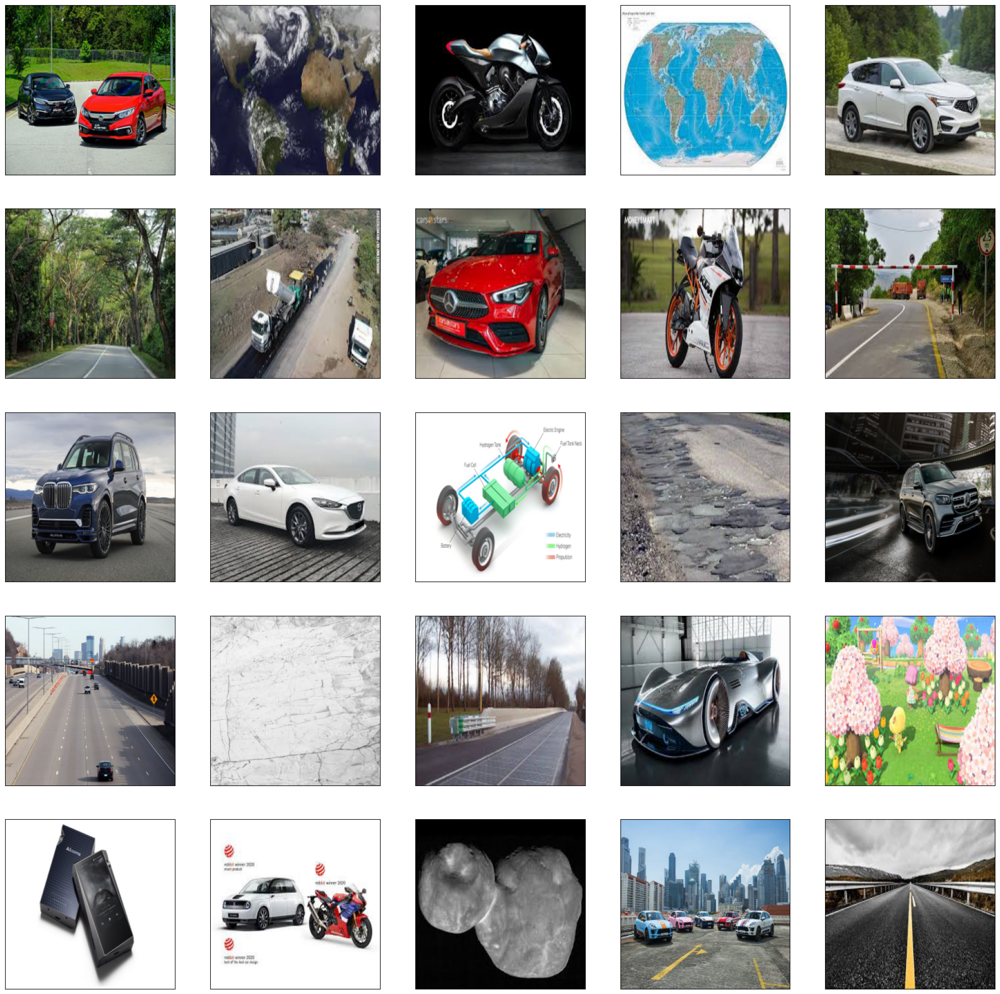

In [20]:
# Выборка изображений в высоком разрешении
plt.figure(figsize=(25, 25))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    # Преобразуем картинку в формат RGB перед выводом
    plt.imshow(cv2.cvtColor(y_train[i], cv2.COLOR_BGR2RGB))
plt.show()

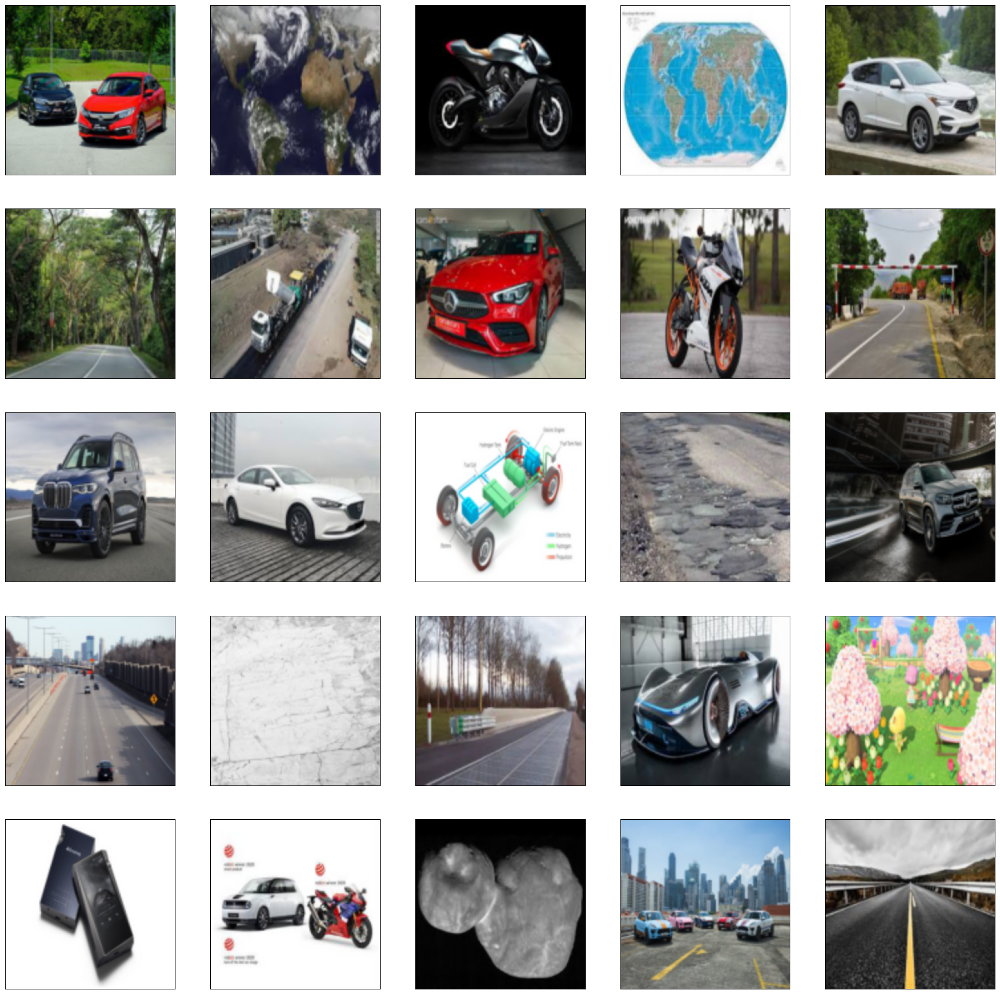

In [21]:
# Выборка изображений в низком разрешении
plt.figure(figsize=(25, 25))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    # Преобразуем картинку в формат RGB перед выводом
    plt.imshow(cv2.cvtColor(X_train[i], cv2.COLOR_BGR2RGB))
plt.show()

In [22]:
# Функции аугментации изображений для увеличения датасета
def data_augmentation(inputImage): # функция прогоняет картинки через все методы аугментации
    return randomContrast(randomBrightness(inputImage)).numpy()

def randomBrightness(pic): # добавляем изображению случайную яркость от 1% до 20%
    return tf.image.random_brightness(pic, random.uniform(0.01, 0.2), 1)

def randomContrast(pic): # добавляем изображению случайную контрастность от 5% до 50%
    return tf.image.random_contrast(pic, 0.2, 0.7, 1)

In [23]:
data_augmented_X = []
data_augmented_y = []

for image in X_train:
    data_augmented_X.append(data_augmentation(image))

for image in y_train:
    data_augmented_y.append(data_augmentation(image))

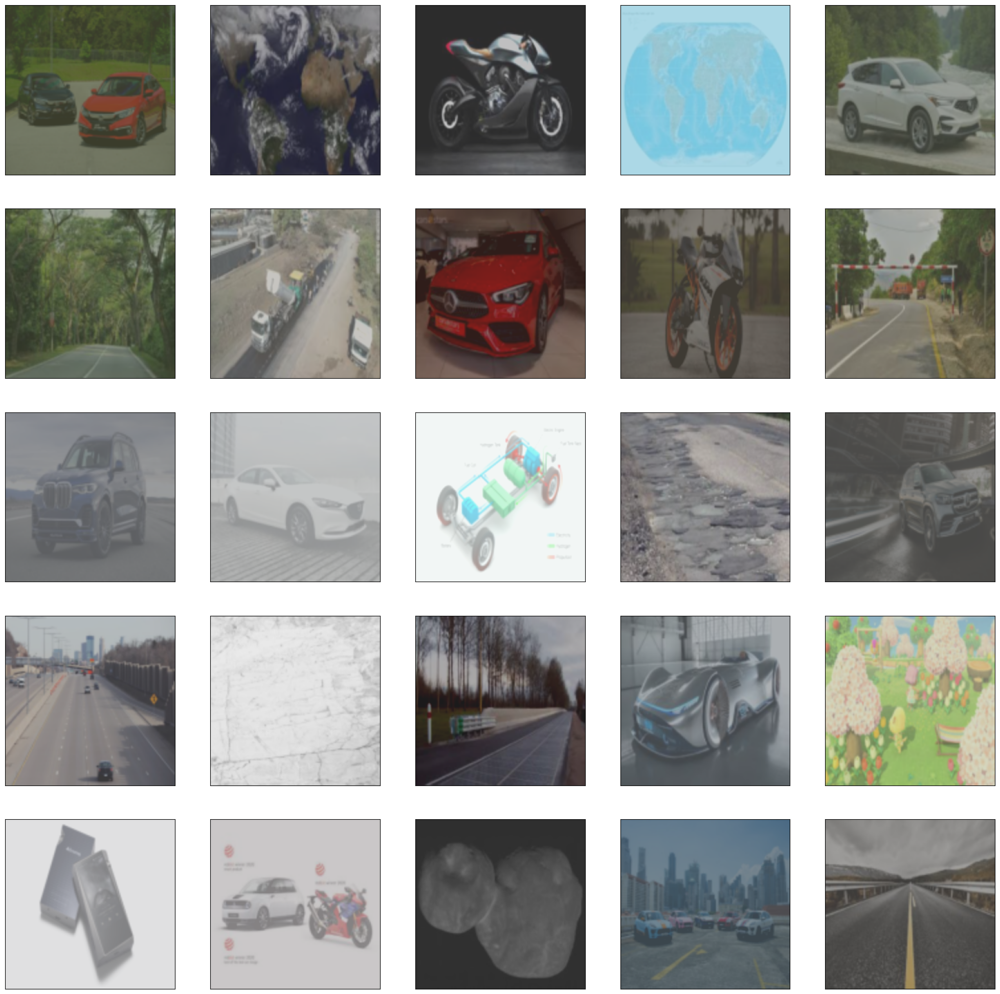

In [24]:
# Выборка из аугментированных данных
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(data_augmented_X[i], cv2.COLOR_BGR2RGB))
plt.show()

In [25]:
# Добавляем аугментированные данные в основной датасет
X_train = np.append(X_train, data_augmented_X, axis=0)
y_train = np.append(y_train, data_augmented_y, axis=0)

In [26]:
# Нормализуем данные
X_train = X_train.astype('float32') / 255.
y_train = y_train.astype('float32') / 255.
X_test = X_test.astype('float32') / 255.
y_test = y_test.astype('float32') / 255.

### Подготовка для SRGAN

Поскольку используемый здесь вариант SRGAN построен на pytorch с использованием собственной функции обучения, то данные для него будут подгатавливаться по-другому, с использованием DataLoader.

In [27]:
# Define the transformations on the data
low_res_size = 128
high_res_size = 256

transform_low = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((low_res_size, low_res_size)),
    transforms.ToTensor(),
])

transform_high = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((high_res_size, high_res_size)),
    transforms.ToTensor(),
])

In [28]:
class ImageDataset(Dataset):
    # This is a custom dataset created using pytorch Dataset
    def __init__(self, root_dir):
        super(ImageDataset, self).__init__()
        self.data = []
        self.root_dir = root_dir
        files_low = os.listdir(os.path.join(root_dir, "low_res"))
        files_high = os.listdir(os.path.join(root_dir, "high_res"))
        self.data = list(zip(files_low, files_high))

        
    def __len__(self):
        return len(self.data)

    def __getitem__(self, index):
        img_low_file, img_high_file = self.data[index]
        
        # Get the path for the image LR and HR
        low_res_pth = os.path.join(self.root_dir, "low_res", img_low_file)
        high_res_pth = os.path.join(self.root_dir, "high_res", img_high_file)

        # Open the actual image
        low_res = np.array(Image.open(low_res_pth))
        high_res = np.array(Image.open(high_res_pth))
        
        # Discarding the alpha channel to make the model more optimized for memory
        low_res = low_res[:, :, :3]
        high_res = high_res[:, :, :3]
        
        # Apply the transformation to the image
        low_res = transform_low(low_res)
        high_res = transform_high(high_res)
        
        return low_res, high_res

In [29]:
batch_size = 16

# Dataloader'ы для подготовки датасета
train = ImageDataset(root_dir="./dataset/train")
train_loader = DataLoader(train, batch_size=batch_size, num_workers=0)

val = ImageDataset(root_dir="./dataset/val")
val_loader = DataLoader(val, batch_size=batch_size, num_workers=0)

## Реализация разных архитектур

### Convolutional Auto-encoder (CAE)

In [30]:
def create_CAE(img_x, img_y, channel):
    inputs = Input(shape=(img_x, img_y, channel))

    # Кодировщик
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = BatchNormalization()(x)

    x = Conv2D(48, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = BatchNormalization()(x)

    # Убираем последний Pooling (оставляем больше информации)
    x = Conv2D(40, (3, 3), activation='relu', padding='same')(x)
    h = x  # Латентное представление

    # Декодировщик - Улучшаем восстановление
    x = Conv2D(40, (3, 3), activation='relu', padding='same')(h)

    x = Conv2D(48, (3, 3), activation='relu', padding='same')(x)  # Доп. слой
    x = UpSampling2D((2, 2))(x)
 
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)  # Доп. слой
    x = UpSampling2D((2, 2))(x)

    outputs = Conv2D(channel, (3, 3), activation='sigmoid', padding='same')(x)

    model = Model(inputs, outputs)
    model.compile(optimizer=Adam(learning_rate=5e-5), loss='mse', metrics=['acc'])
    return model

### Super Resolution Generative Adversarial Network (SRGAN)

In [31]:
lr = 3e-4
epochs = 30
batch_size = 16
num_workers = 0
img_channels = 3

In [32]:
device = "cuda" if torch.cuda.is_available() else "cpu"

test_vgg_model = vgg19(weights=True).eval().to(device)
lf = list(test_vgg_model.features)
lf[25]

e:\Programs\Python_Anaconda\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))

In [33]:
# Вычисление VGG-потерь
class vggL(nn.Module):
    def __init__(self):
        super().__init__()
        self.vgg = vgg19(pretrained=True).features[:25].eval().to(device)
        self.loss = nn.MSELoss()

    def forward(self, first, second):
        vgg_first = self.vgg(first)
        vgg_second = self.vgg(second)
        perceptual_loss = self.loss(vgg_first, vgg_second)
        return perceptual_loss

In [34]:
# Класс сверточного блока
class ConvBlock(nn.Module):
    # Conv -> BN -> leakyReLU
    def __init__(
            self,
            in_channels,
            out_channels,
            use_activation=True,
            use_BatchNorm=True,
            **kwargs
    ):
        
        super().__init__()
        self.use_activation = use_activation
        self.cnn = nn.Conv2d(in_channels, out_channels, **kwargs)
        self.bn = nn.BatchNorm2d(out_channels) if use_BatchNorm else nn.Identity()
        self.ac = (
            nn.LeakyReLU(0.2, inplace=True)
        )

    def forward(self, x):
        x1 = self.cnn(x)
        x2 = self.bn(x1)
        x3 = self.ac(x2)
        return x3 if self.use_activation else x2

In [35]:
# Класс upsampling-блока
class UpsampleBlock(nn.Module):
    def __init__(self, in_channels, scale_factor = 2):
        super().__init__()
        self.conv = nn.Conv2d(in_channels, in_channels * scale_factor ** 2, 2, 1, 1)
        self.ps = nn.PixelShuffle(scale_factor)
        self.ac = nn.PReLU(num_parameters=in_channels)

    def forward(self, x):
        return self.ac(self.ps(self.conv(x)))

In [36]:
# Класс остаточного блока
class ResidualBlock(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        self.b1 = ConvBlock(
            in_channels,
            in_channels,
            kernel_size=3,
            stride=1,
            padding=1
        )

        self.b2 = ConvBlock(
            in_channels,
            in_channels,
            kernel_size=3,
            stride=1,
            padding=1,
            use_activation=False
        )

    def forward(self, x):
        out = self.b1(x)
        out = self.b2(out)
        return out + x

In [37]:
# Класс генератора
class Generator(nn.Module):
    def __init__(self, in_channels=3, num_channels=64, num_blocks=8):
        super().__init__()
        self.initial = ConvBlock(in_channels, num_channels, kernel_size=7, stride=1, padding=4, use_BatchNorm=False)
        self.res = nn.Sequential(*[ResidualBlock(num_channels) for i in range(num_blocks)])
        self.conv = ConvBlock(num_channels, num_channels, kernel_size=3, stride=1, padding=1, use_activation=False)
        self.up = nn.Sequential(UpsampleBlock(num_channels, scale_factor=2)) 
        self.final = nn.Conv2d(num_channels, in_channels, kernel_size=9, stride=1, padding=1)

    def forward(self, x):
        x = self.initial(x)
        c = self.res(x)
        c = self.conv(c) + x
        c = self.up(c)
        return torch.sigmoid(self.final(c))

In [38]:
# Класс дискриминатора
class Discriminator(nn.Module):
    def __init__(self, in_channels=3, features=[64, 64, 128, 128, 256, 256, 512, 512]):
        super().__init__()
        blocks = []
        for idx, feature in enumerate(features):
            blocks.append(
                ConvBlock(
                    in_channels,
                    feature,
                    kernel_size=3,
                    stride = idx % 2 + 1,
                    padding=1,
                    use_activation=True,
                    use_BatchNorm=idx != 0,
                )
            )
            in_channels = feature

        self.blocks = nn.Sequential(*blocks)

        self.mlp = nn.Sequential(
            nn.AdaptiveAvgPool2d((8, 8)),
            nn.Flatten(),
            nn.Linear(512*8*8, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 1)
        )

    def forward(self, x):
        x = self.blocks(x)
        x = self.mlp(x)
        return x

In [39]:
# Отображение промежуточных результатов на каждой эпохе обучения
def plot_examples(gen):
    dataset_test = ImageDataset(root_dir="./dataset/val")
    loader = DataLoader(dataset_test, batch_size=16, num_workers=0)
    
    fig, axs = plt.subplots(1, 3, figsize=(8, 4))
    chosen_batch = random.randint(0, len(loader)-1)
    for idx, (low_res, high_res) in enumerate(loader):
        if(chosen_batch == idx):
            chosen = random.randint(0, len(low_res)-1)
        
            axs[0].set_axis_off()
            axs[0].imshow(low_res[chosen].permute(1, 2, 0))
            axs[0].set_title("low res")

            with torch.no_grad():
                upscaled_img = gen(low_res[chosen].to(device).unsqueeze(0))
        
            axs[1].set_axis_off()
            axs[1].imshow(upscaled_img.cpu().permute(0, 2, 3, 1)[0])
            axs[1].set_title("predicted")
        
            axs[2].set_axis_off()
            axs[2].imshow(high_res[chosen].permute(1, 2, 0))
            axs[2].set_title("high res")
        
            if(idx == 1):
                break
            
    # Show the figure
    plt.show()      
    
    gen.train()

In [40]:
# Прогресс обучения
def train_progress(epoch, num_epochs, d_losses, g_losses):
    clear_output(wait=True)
    plt.figure(figsize=(10,5))
    plt.title("Training progress")
    plt.plot(d_losses,label="Discriminator loss")
    plt.plot(g_losses,label="Generator loss")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

    print(f"Epoch [{epoch}/{num_epochs}], Discriminator loss: {d_losses[-1]:.4f}, Generator loss: {g_losses[-1]:.4f}")
    

In [41]:
#Определение гиперпараметров
gen = Generator(in_channels=3).to(device)
disc = Discriminator(in_channels=3).to(device)
opt_gen = optim.Adam(gen.parameters(), lr=lr, betas=(0.9, 0.999))
opt_disc = optim.Adam(disc.parameters(), lr=lr, betas=(0.9, 0.999))
mse = nn.MSELoss()
bce = nn.BCEWithLogitsLoss()
vgg_loss = vggL()

e:\Programs\Python_Anaconda\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(


In [42]:
# Функция тренировки модели
def train_fn(loader, disc, gen, opt_gen, opt_disc, mse, bce, vgg_loss):
    loop = tqdm(train_loader)
    disc_loss = 0
    gen_loss = 0

    for idx, (low_res, high_res) in enumerate(loop):
        high_res = high_res.to(device)
        low_res = low_res.to(device)
        
        ### Train Discriminator: max log(D(x)) + log(1 - D(G(z)))
        fake = gen(low_res)
        
        disc_real = disc(high_res)
        disc_fake = disc(fake.detach())
        
        disc_loss_real = bce(disc_real, torch.ones_like(disc_real))
        disc_loss_fake = bce(disc_fake, torch.zeros_like(disc_fake))
        
        disc_loss = disc_loss_fake + disc_loss_real

        opt_disc.zero_grad()
        disc_loss.backward()
        opt_disc.step()

        # Train Generator: min log(1 - D(G(z))) <-> max log(D(G(z))
        disc_fake = disc(fake)
        adversarial_loss = 1e-3 * bce(disc_fake, torch.ones_like(disc_fake))
        loss_for_vgg = 0.006 * vgg_loss(fake, high_res)
        gen_loss = loss_for_vgg + adversarial_loss

        opt_gen.zero_grad()
        gen_loss.backward()
        opt_gen.step()

            
    return gen_loss.detach().cpu(), disc_loss.detach().cpu()

## Обучение сетей

### CAE

In [43]:
upscaler_auto_encoder = create_CAE(width, height, 3)

In [44]:
early_stop = EarlyStopping(monitor='loss', patience=6, restore_best_weights=True)
history = upscaler_auto_encoder.fit(X_train, y_train, batch_size=64, epochs=100, callbacks=[early_stop])

Epoch 1/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 29s 1s/step - acc: 0.2018 - loss: 0.0600
Epoch 2/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step - acc: 0.3196 - loss: 0.0262
Epoch 3/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 29s 1s/step - acc: 0.4838 - loss: 0.0168
Epoch 4/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step - acc: 0.6401 - loss: 0.0146
Epoch 5/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 29s 1s/step - acc: 0.6506 - loss: 0.0139
Epoch 6/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step - acc: 0.6559 - loss: 0.0133
Epoch 7/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step - acc: 0.6602 - loss: 0.0128
Epoch 8/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step - acc: 0.6704 - loss: 0.0124
Epoch 9/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step - acc: 0.6645 - loss: 0.0122
Epoch 10/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step - acc: 0.6823 - loss: 0.0119
Epoch 11/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step - acc: 0.6781 - loss: 0.0109
Epoch 12/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step - acc: 0.6792 - loss: 0.0113
Epoch 13/100
22/22 ━━━━━━━━━━━━━━━━━━

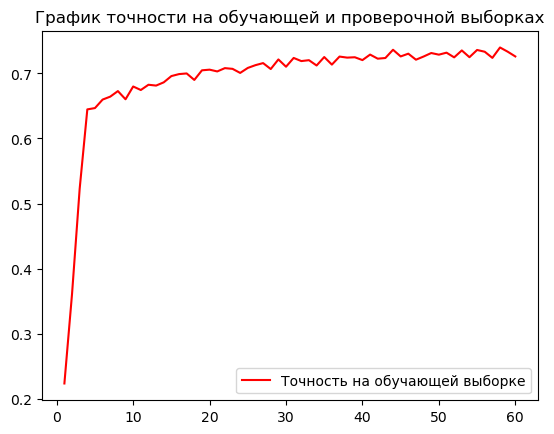

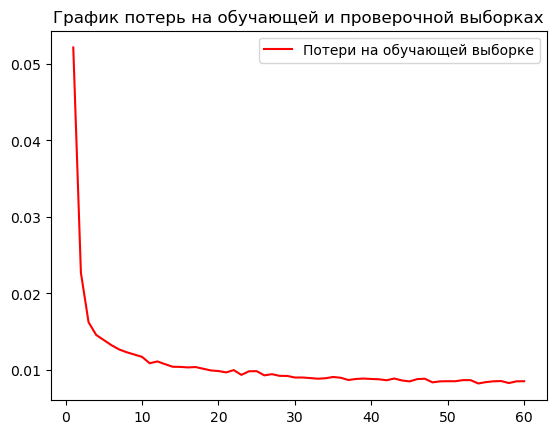

In [45]:
import matplotlib.pyplot as plt           # библиотека для рисования графиков
acc = history.history['acc']              # данные о точности на обучающей выборке
loss = history.history['loss']            # данные об ошибке на обучающей выборке
epochs = range(1, len(acc) + 1)           # массив со значениями для оси абсцисс (Х)
plt.plot(epochs, acc, 'r', label='Точность на обучающей выборке')          #  строим график точность на обучающей выборке
plt.title('График точности на обучающей и проверочной выборках')           #  заголовок графика
plt.legend()                                                               #  легенда графика
plt.figure()                                                               #  создаем новую фигуру (полотно для графика)
plt.plot(epochs, loss, 'r', label='Потери на обучающей выборке')           #  строим график потерь (ошибки) на обучающей выборке
plt.title('График потерь на обучающей и проверочной выборках')             #  заголовок графика
plt.legend()                                                               #  легенда графика
plt.show() 

### SRGAN

In [ ]:
d_losses = []
g_losses = []

epochs = 50
for epoch in range(epochs):
     plot_examples(gen)
     print("epoch ", epoch+1, "/", epochs)
     gen_loss, disc_loss = train_fn(train_loader, disc, gen, opt_gen, opt_disc, mse, bce, vgg_loss)
     # train discriminator and generator and update losses
     d_losses.append(disc_loss)
     g_losses.append(gen_loss)

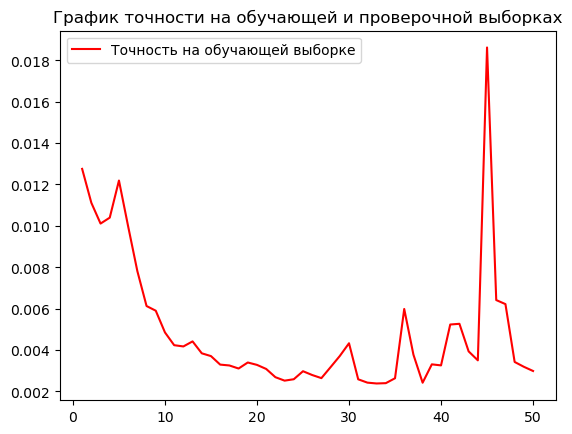

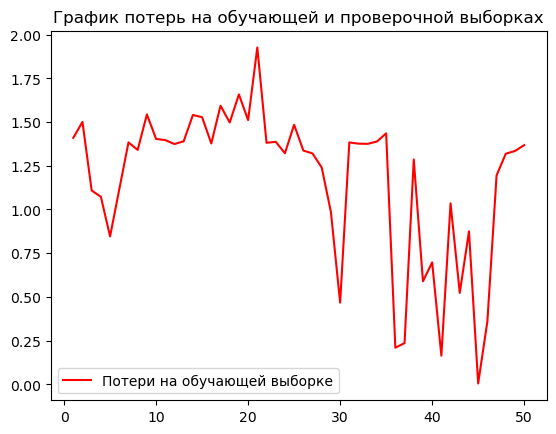

In [47]:
# данные об ошибке на обучающей выборке
epochs = range(1, 51)           # массив со значениями для оси абсцисс (Х)
plt.plot(epochs, g_losses, 'r', label='Точность на обучающей выборке')          #  строим график точность на обучающей выборке
plt.title('График точности на обучающей и проверочной выборках')           #  заголовок графика
plt.legend()                                                               #  легенда графика
plt.figure()                                                               #  создаем новую фигуру (полотно для графика)
plt.plot(epochs, d_losses, 'r', label='Потери на обучающей выборке')           #  строим график потерь (ошибки) на обучающей выборке
plt.title('График потерь на обучающей и проверочной выборках')             #  заголовок графика
plt.legend()                                                               #  легенда графика
plt.show() 

## Сравнение результатов

### CAE

6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 155ms/step


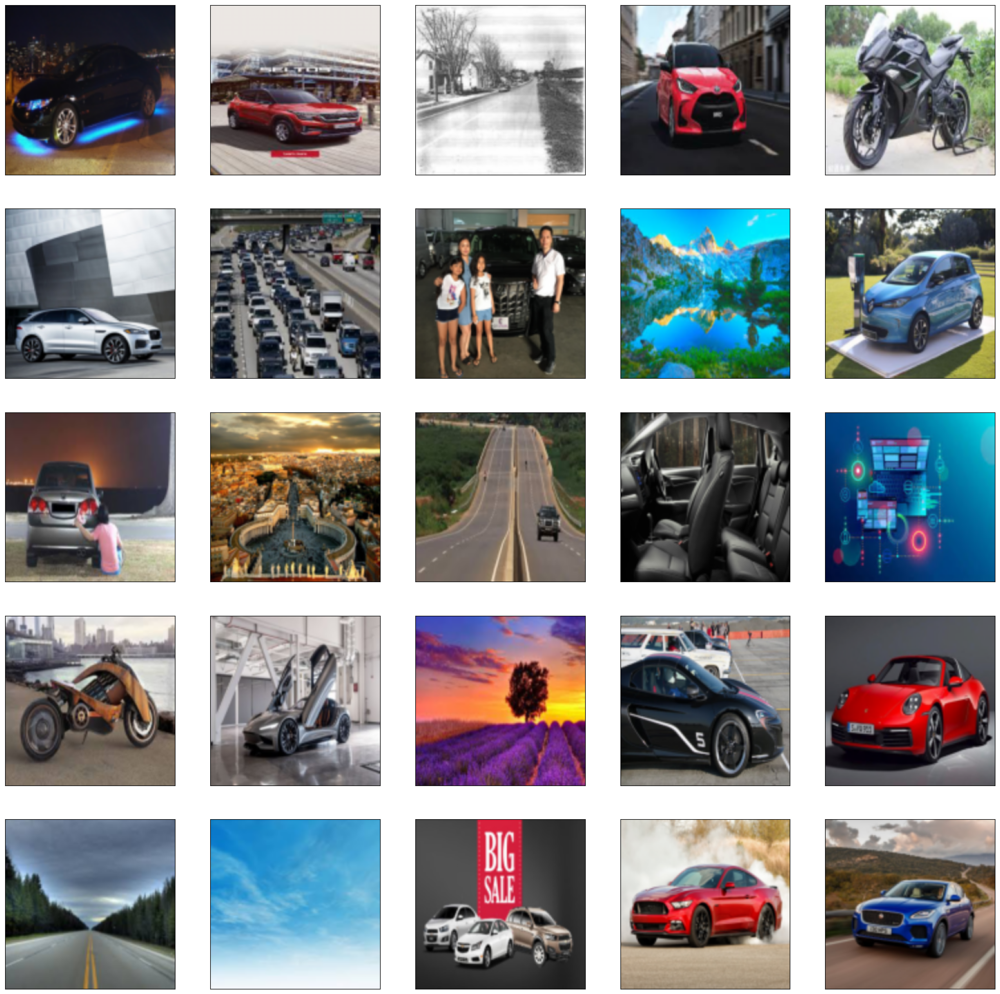

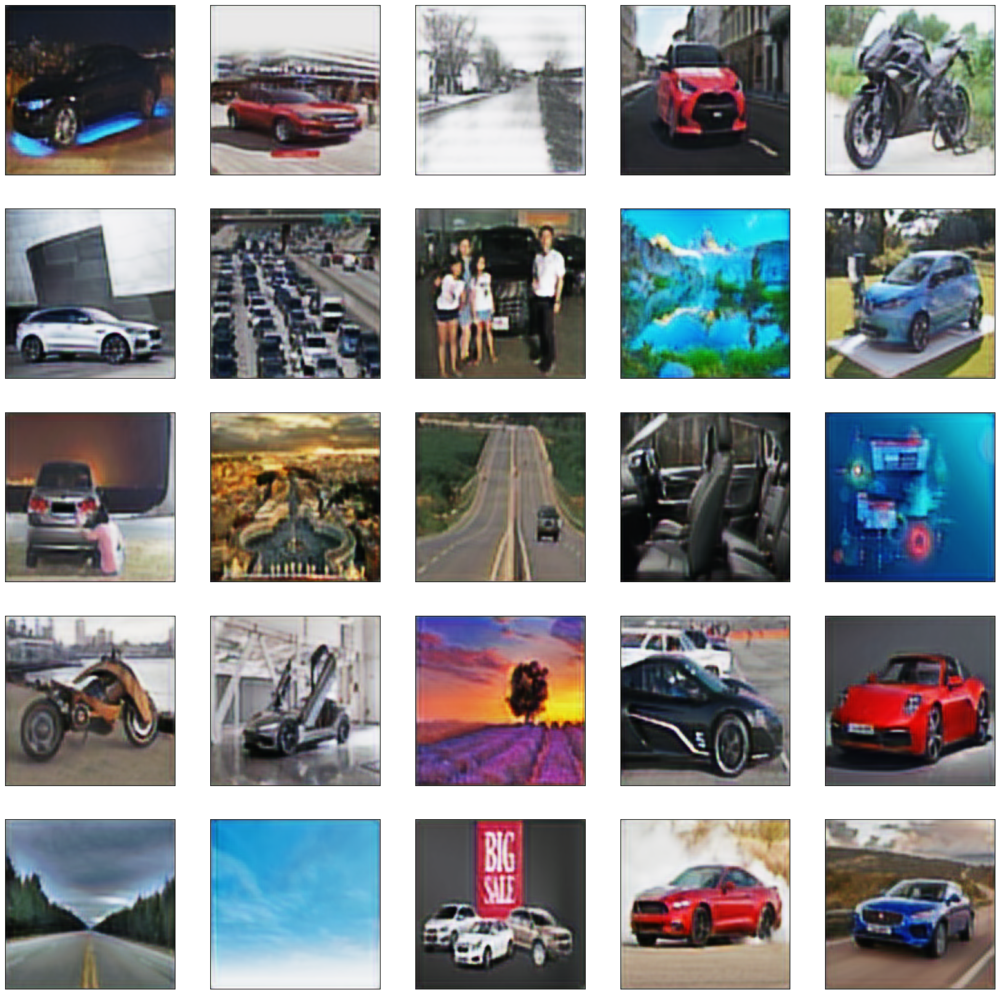

In [48]:
#CAE
result = upscaler_auto_encoder.predict(X_test)

plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(X_test[i].astype('float32'), cv2.COLOR_BGR2RGB))
plt.show()

plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(result[i], cv2.COLOR_BGR2RGB))
plt.show()

### SRGAN

In [ ]:
#SRGAN
def test_print(image_path):
    img = image_path
    img = np.array(Image.open(img))
    img = img[:, :, :3]
    img = transform_low(img)

    loader = DataLoader(img)

    with torch.no_grad():  # Отключаем градиенты для ускорения
        upscaled_img = gen(img.to(device).unsqueeze(0))

    img1 = mpimg.imread(image_path)

    plt.figure(figsize=(150, 75))

    # Первое изображение
    plt.subplot(1, 2, 1)  # 1 строка, 2 столбца, первый график
    plt.imshow(img1)
    plt.axis("off")
    plt.title("Изображение 1")

    # Второе изображение
    plt.subplot(1, 2, 2)  # 1 строка, 2 столбца, второй график
    plt.imshow(upscaled_img.cpu().permute(0,2,3,1)[0])
    plt.axis("off")
    plt.title("Изображение 2")

    plt.show()

In [ ]:
test_print("./dataset/val/low_res/0.png")
test_print("./dataset/val/low_res/1.png")
test_print("./dataset/val/low_res/2.png")
test_print("./dataset/val/low_res/3.png")
test_print("./dataset/val/low_res/4.png")
test_print("./dataset/val/low_res/5.png")


### ESRGAN

In [ ]:
# ESRGAN
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = RealESRGAN(device, scale=4)
model.load_weights('weights/RealESRGAN_x4.pth', download=True)

path_to_image = './my_test/image_3.jpg'
image = Image.open(path_to_image).convert('RGB')

sr_image = model.predict(image)
sr_image.save('my_test/sr_image.png')


In [74]:
def test_print_esrgan(path, save_location):
    path_to_image = path
    image = Image.open(path_to_image).convert('RGB')

    sr_image = model.predict(image)
    sr_image.save(save_location) 

    fig, axes = plt.subplots(1, 2, figsize=(150, 75))  # figsize задает размер
    img1 = mpimg.imread(path)
    img2 = mpimg.imread(save_location)
    # Отображаем первое изображение
    axes[0].imshow(img1)
    axes[0].axis("off")  # Убираем оси
    axes[0].set_title("Оригинал")

    # Отображаем второе изображение
    axes[1].imshow(img2)
    axes[1].axis("off")
    axes[1].set_title("Обработка")

In [ ]:
test_print_esrgan("./dataset/val/low_res/0.png", 'my_test/sr_image_4.png')
test_print_esrgan("./dataset/val/low_res/3.png", 'my_test/sr_image_5.png')
test_print_esrgan("./dataset/val/low_res/4.png", 'my_test/sr_image_6.png')
test_print_esrgan('./my_test/image_3.jpg', 'my_test/sr_image.png' )
test_print_esrgan('./my_test/image_test.jpg', 'my_test/sr_image_2.png' )
test_print_esrgan('./my_test/image_2.png', 'my_test/sr_image_3.png' )

# Заключение

Учитывая малое число эпох обучения и количество тренировочных данных, даже с учетом синтетики, классический автокодировщик и SRGAN показали неплохие результаты. В данном случае ESRGAN не обсуждается, т.к. был уже предобучен на большом датасете.<br><br>
Однако, автокодировщик отстает из-за "бутылочного горлышка" - при любом раскладе при прохождении через него будут безвозвратно теряться данные. Хоть это и компенсируется генерацией самой модели, но исходного разрешения добиться не получится.<br><br>
У SRGAN и ESRGAN же это компенсируется наличием остаточных блоков, позволяющих решить проблему затухающего градиента и передавать неизмененные данные напрямую в дальние слои.<br><br>
При прочих идентичных условиях, ESRGAN показал бы наилучший результат за счет улучшенных остаточных блоков и релтивистского генератора, позволяющих выделять больше деталей на изображении.

Среди преимуществ простых автокодировщиков можно выделить нетребовательность к ресурсам, поэтому можно легко натренировать модель для несложной реставрации изображений или устранения шумов.